## Week 10 - Time Series Analysis and Forecasting

Welcome to Week 10 of our Technical Training Series, where we delve into the fundamentals and applications of Time Series Analysis and Forecasting. In today’s data-driven world, time series analysis has become essential across various fields, including finance, economics, environmental science, and more. This week, we aim to equip you with a solid foundation in time series modeling techniques that will enable you to understand and forecast patterns within temporal data.

Time series analysis involves examining data points collected or recorded at specific time intervals, which often exhibit trends, seasonal fluctuations, and other recurring patterns. Our goal is to explore these patterns and gain insights that inform data-driven decisions. In this tutorial, we will cover critical concepts and methods in time series analysis, including:

1. Time Series Decomposition – Breaking down time series data into its core components: trend, seasonal, and residual elements, allowing us to understand the underlying structure of the data.
2. Autoregressive (AR) Models – A foundational model that leverages the dependency between an observation and a series of lagged observations, capturing autocorrelations in the data.
3. Moving Average (MA) Models – Techniques that utilize past forecast errors in a regression-like model to smooth and capture noise within the data.
4. FB Prophet – A business focused open-sourced tool developed by Facebook that automatically integrates seasonality and trends into the modeling with good performance out of the box.
5. ARIMA Models (AutoRegressive Integrated Moving Average) – An advanced and popular technique that combines AR and MA components and adjusts for non-stationarity to create robust time series forecasts.

Throughout this session, we will not only discuss these methods but also demonstrate how to apply them in real-world contexts. By the end of this tutorial, you’ll be equipped with the practical skills and theoretical knowledge to analyze, interpret, and predict time series data effectively. Let’s get started on the journey of mastering time series analysis and building reliable forecasting models!



### Time Series Data

Time series data refers to a sequence of data points collected or recorded at successive, evenly spaced time intervals. Unlike other data types that may be independent of order, time series data inherently captures temporal dependencies, where each observation is linked to the time at which it occurred. This characteristic makes time series analysis unique, as it focuses on uncovering patterns, trends, seasonal variations, and potential cyclic behaviors over time.

Time series data is prevalent across various industries, offering critical insights into past behaviors and facilitating forecasts of future events. Some common examples of time series datasets include:

* Stock Market Prices: Daily or minute-by-minute prices of stocks, indexes, or other financial assets that show how market conditions fluctuate over time.
* Weather Data: Temperature, humidity, and precipitation records, typically collected at daily or hourly intervals, reflecting seasonal and long-term climate patterns.
* Sales and Revenue Data: Weekly, monthly, or quarterly sales figures for businesses, providing insights into demand cycles, seasonal spikes, and market trends.

In this example, we will use the well-known bike_sharing dataset.

In [2]:
library(tidyverse)
library(tsibble)
library(ggplot2)
library(ggthemr)
library(modeltime)
library(tidymodels)
library(lubridate)
library(timetk)
library(tidyquant)
library(forecast)

ggthemr('flat')

bike_sharing_data <- as_tibble(read.csv('Datasets/bike_sharing_daily.csv'))
bike_sharing_data %>% slice_head(n=10)

instant,dteday,season,yr,mnth,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
<int>,<chr>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>
1,2011-01-01,1,0,1,0,6,0,2,0.344167,0.363625,0.805833,0.1604460,331,654,985
2,2011-01-02,1,0,1,0,0,0,2,0.363478,0.353739,0.696087,0.2485390,131,670,801
3,2011-01-03,1,0,1,0,1,1,1,0.196364,0.189405,0.437273,0.2483090,120,1229,1349
4,2011-01-04,1,0,1,0,2,1,1,0.200000,0.212122,0.590435,0.1602960,108,1454,1562
5,2011-01-05,1,0,1,0,3,1,1,0.226957,0.229270,0.436957,0.1869000,82,1518,1600
6,2011-01-06,1,0,1,0,4,1,1,0.204348,0.233209,0.518261,0.0895652,88,1518,1606
7,2011-01-07,1,0,1,0,5,1,2,0.196522,0.208839,0.498696,0.1687260,148,1362,1510
8,2011-01-08,1,0,1,0,6,0,2,0.165000,0.162254,0.535833,0.2668040,68,891,959
9,2011-01-09,1,0,1,0,0,0,1,0.138333,0.116175,0.434167,0.3619500,54,768,822


In [3]:
colnames(bike_sharing_data)

[1] "instant"    "dteday"     "season"     "yr"         "mnth"      
 [6] "holiday"    "weekday"    "workingday" "weathersit" "temp"      
[11] "atemp"      "hum"        "windspeed"  "casual"     "registered"
[16] "cnt"

In [4]:
glimpse(bike_sharing_data)

Rows: 731
Columns: 16
$ instant    <int> 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, ~
$ dteday     <chr> "2011-01-01", "2011-01-02", "2011-01-03", "2011-01-04", "20~
$ season     <int> 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,~
$ yr         <int> 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,~
$ mnth       <int> 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,~
$ holiday    <int> 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,~
$ weekday    <int> 6, 0, 1, 2, 3, 4, 5, 6, 0, 1, 2, 3, 4, 5, 6, 0, 1, 2, 3, 4,~
$ workingday <int> 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1,~
$ weathersit <int> 2, 2, 1, 1, 1, 1, 2, 2, 1, 1, 2, 1, 1, 1, 2, 1, 2, 2, 2, 2,~
$ temp       <dbl> 0.3441670, 0.3634780, 0.1963640, 0.2000000, 0.2269570, 0.20~
$ atemp      <dbl> 0.3636250, 0.3537390, 0.1894050, 0.2121220, 0.2292700, 0.23~
$ hum        <dbl> 0.805833, 0.696087, 0.437273, 0.590435, 0.436957, 0.518261,~
$ windspeed  <dbl>

### Visualizing the Dataset

Visualizing daily bike sharing data provides insights into patterns, trends, and seasonal effects, helping to understand user behavior over time. In this example, we use the timetk plot_time_series function that by default offers an interactive way to visualize the data.

In [5]:
bike_sharing_data |> 
  mutate( date = as.Date(dteday) ) |>
  select(date, value = cnt) |> 
  plot_time_series(date, value, 
                   .interactive = TRUE, 
                   .title="Bike Sharing Daily Data", 
                   .x_lab = "Day", .y_lab = 'Bike Count', .smooth = FALSE)

HTML widgets cannot be represented in plain text (need html)

### Component of Time Series Data

Time series data typically consists of four main components that help us understand and model its underlying structure:

1. Trend (T): The long-term movement or direction in the data, representing a gradual increase or decrease over time. The trend component captures sustained upward or downward shifts.
2. Seasonality (S): Repeated patterns or cycles within fixed periods, such as daily, weekly, or yearly fluctuations. Seasonality is often influenced by external factors like weather, holidays, or business cycles.
3. Cyclic Patterns (C): Long-term oscillations that do not have a fixed period, unlike seasonality. Cyclic components reflect economic or business cycles, often lasting several years.
4. Residual (R): The random or irregular component that represents noise or random fluctuations in the data. These variations are typically unpredictable and often treated as error.

The relationship between these components can often be represented in two common models:

* Additive Model: Suitable when the magnitude of seasonality remains constant over time. In this model:

$$ Y_t = T_t + S_t + C_t + R_t $$

* Multiplicative Model: Useful when the magnitude of seasonality varies with the level of the trend. Here, the model is:

$$
Y_t = T_t \times S_t \times C_t \times R_t
$$

Understanding these components is crucial in decomposing the time series data, allowing us to analyze each part separately and build more accurate forecasting models.

### Decomposing Time Series

Decomposing a time series involves breaking it down into its fundamental components—Trend, Seasonality, and Residual—to analyze and interpret each separately. In the following example, we demonstrate how to decompose a time series object on a sample stock data for AAPL, where we observe a mix of long-term trends, seasonal cycles, and random variations.

In [7]:
#| out-width: 100%
#| out-height: 100%
options(repr.plot.width = 9, repr.plot.height = 12)

bike_sharing_data |> 
  mutate( date = as.Date(dteday) ) |>
  select(date, value = cnt) |> 
  plot_stl_diagnostics(date, value, 
                      .interactive = TRUE, 
                      .feature_set = c("observed", "season", "trend", "remainder"),
                      .frequency = "auto",
                      .trend = "auto",
                      .title="Bike Sharing Daily Data", 
                      .x_lab = "Day", .y_lab = 'Bike Count')


frequency = 7 observations per 1 week

trend = 92 observations per 3 months



HTML widgets cannot be represented in plain text (need html)

### Alternative with decompose function

Another alternative to visualize the time series component decomposition is to use the decompose function. A demonstration is given below:

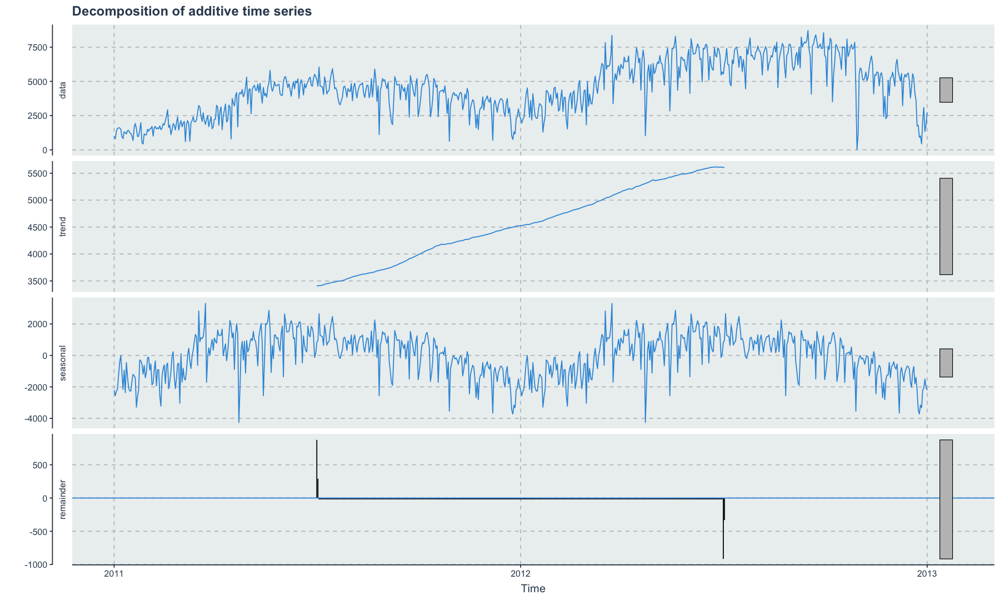

In [11]:
# decomposition
options(repr.plot.width = 15, repr.plot.height = 9)
ts_decomp <- decompose( ts(bike_sharing_data$cnt, start = c(2011, 01,01), frequency = 365))
autoplot(ts_decomp)

### Stationarity in Time Series Data

Stationarity is a fundamental concept in time series analysis that describes a series whose statistical properties—such as mean, variance, and autocorrelation—remain constant over time. Stationary time series are easier to model and predict, as they exhibit consistent patterns, making it possible to identify relationships in past data that can be reliably extended into the future.

### Testing for Stationarity:

A popular method to test for stationarity is the Augmented Dickey-Fuller (ADF) test. This test checks whether a unit root (a sign of non-stationarity) exists in the series. If the ADF test indicates the presence of a unit root, the series is likely non-stationary.

In [12]:
library(tseries)

# Perform the ADF test
adf_result <- adf.test(ts(bike_sharing_data$cnt, start = c(2011, 01,01), frequency = 365), alternative = "stationary")

# Display the test result
print(adf_result)


	Augmented Dickey-Fuller Test

data:  ts(bike_sharing_data$cnt, start = c(2011, 1, 1), frequency = 365)
Dickey-Fuller = -1.6351, Lag order = 9, p-value = 0.7327
alternative hypothesis: stationary



### Dealing with Non-Stationary Data:

When a time series is non-stationary, transformations can often help stabilize its properties. Common techniques include:

* Differencing: Subtracting the previous observation from the current one to remove trends.

* Log Transformation: Applying a logarithmic transformation to reduce variance, especially in data with exponential growth.

* Detrending: Removing the trend component to achieve stationarity.

In the code below we implement the common differencing method.

In [13]:
# First-order differencing
diff_data <- diff(ts(bike_sharing_data$cnt, start = c(2011, 01,01), frequency = 365), differences = 1)

# Perform the ADF test
adf_result <- adf.test(diff_data, alternative = "stationary")

# Display the test result
print(adf_result)

Warning message in adf.test(diff_data, alternative = "stationary"):
"p-value smaller than printed p-value"



	Augmented Dickey-Fuller Test

data:  diff_data
Dickey-Fuller = -13.798, Lag order = 8, p-value = 0.01
alternative hypothesis: stationary



## Autocorrelation and Partial Autocorrelation Functions

Autocorrelation and partial autocorrelation are essential tools in time series analysis for identifying the relationships between observations at different time lags. They help us understand how past values in a series are related to future values, which is particularly useful when building autoregressive models like ARIMA.

1. Autocorrelation Function (ACF): The autocorrelation function measures the correlation between observations in a time series separated by various lags. If a time series has a significant autocorrelation at a particular lag, it implies that past values influence current values up to that lag. Plotting the ACF helps identify how many previous values influence the current value and whether the series is stationary.

2. Partial Autocorrelation Function (PACF): The partial autocorrelation function isolates the correlation at each lag by removing the influence of any shorter lags. It shows the direct effect of a lagged observation on the current value, excluding the effects of any intermediate lags. PACF is especially useful for determining the order of an autoregressive (AR) model, as significant lags in the PACF indicate the AR terms required for modeling.

In R, we can plot the ACF and PACF using the acf and pacf functions.

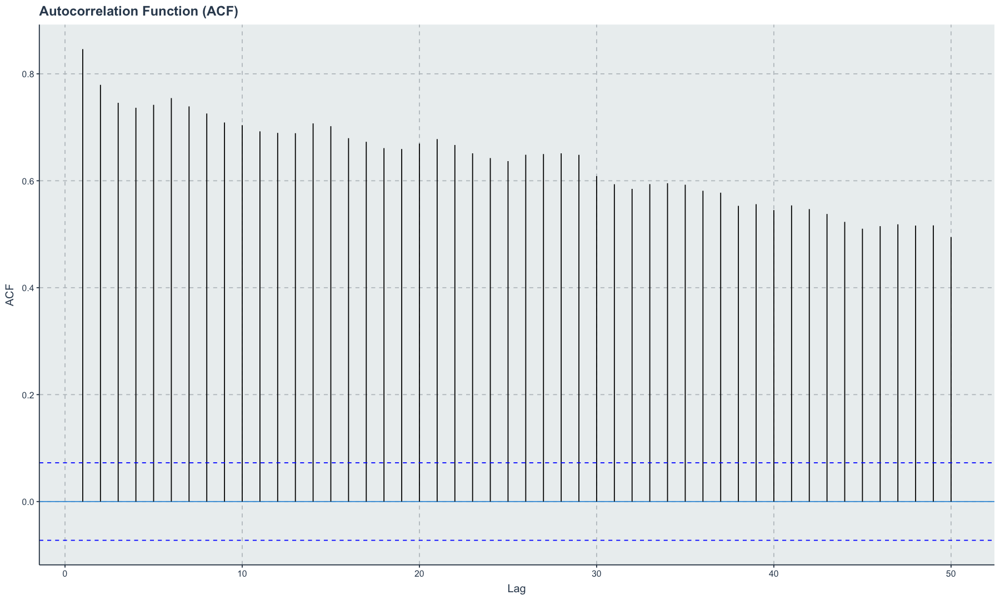

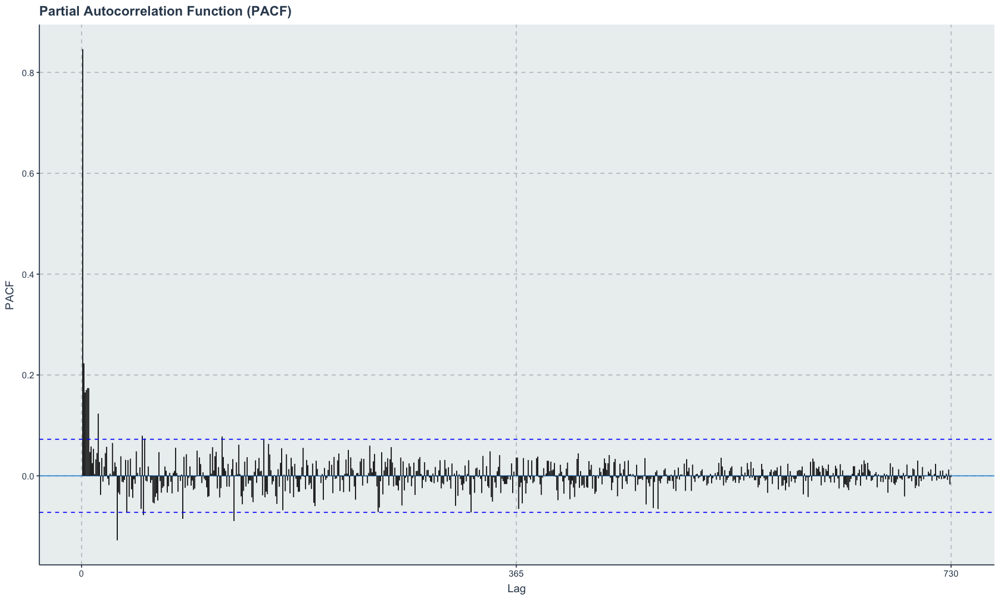

In [14]:
# Autocorrelation Function (ACF) plot
ggAcf(ts(bike_sharing_data$cnt, start = c(2011, 01,01), frequency = 365), 
      lag.max = 50) + ggtitle("Autocorrelation Function (ACF)")

# Partial Autocorrelation Function (PACF) plot
ggPacf(ts(bike_sharing_data$cnt, start = c(2011, 01,01), frequency = 365)) + ggtitle("Partial Autocorrelation Function (PACF)")

Warning message in ggplot2::geom_segment(lineend = "butt", ...):
"Ignoring unknown parameters: `main`"
Warning message in ggplot2::geom_segment(lineend = "butt", ...):
"Ignoring unknown parameters: `main`"


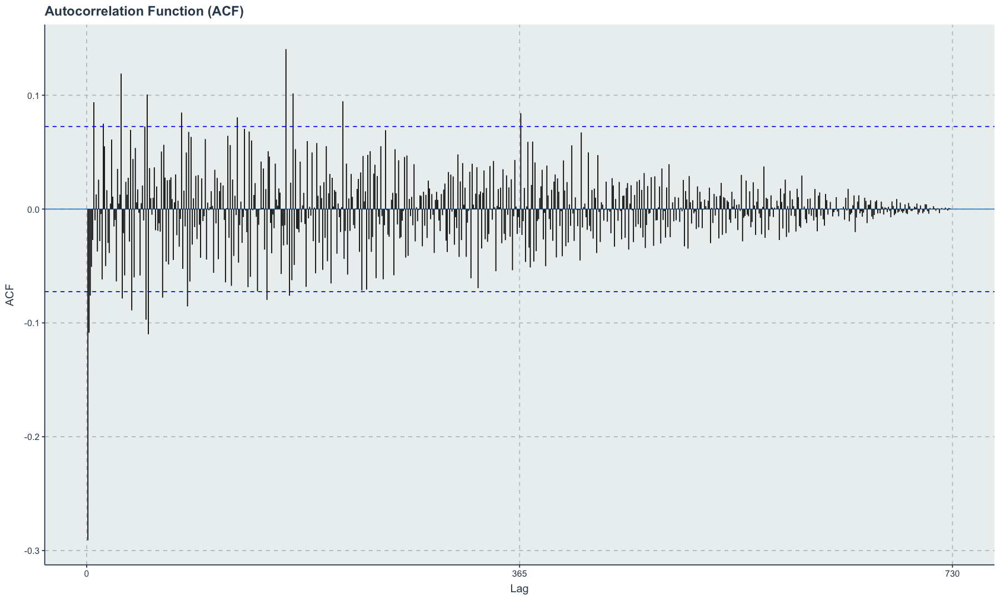

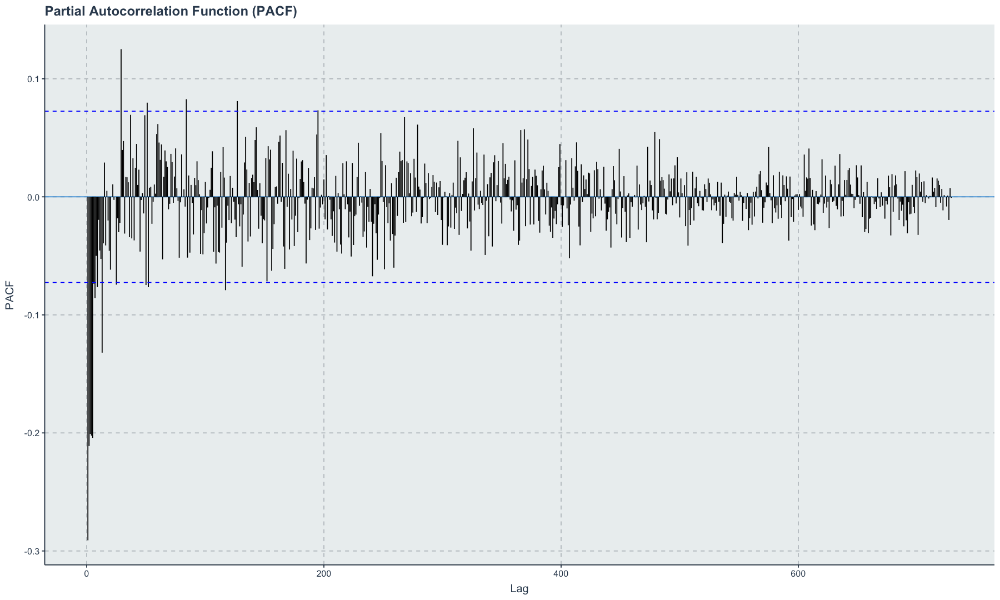

In [16]:
# Autocorrelation Function (ACF) plot
ggAcf(diff_data, main = "Autocorrelation Function (ACF)")

# Partial Autocorrelation Function (PACF) plot
ggPacf(diff_data, main = "Partial Autocorrelation Function (PACF)")

## Training Time Series Models

In this section, we will train time series models using the prophet, ARIMA, and lm methods, all implemented within the tidymodels framework. The tidymodels suite provides a cohesive and consistent approach for training and evaluating models. We will begin by splitting the data into a training and testing set, then proceed to fit each model.

### Step 1: Splitting the Data

Before training, we’ll split the data into a training set (used to fit the models) and a testing set (used for validation). This step ensures that we can evaluate how well our models generalize to new data.

In [17]:
# getting the bike data
bike_data <- bike_sharing_data |> mutate( date = as.Date(dteday) ) |> select(date, value = cnt) 

# Initial data split for training and testing (e.g., last 20% as testing)
data_split <- initial_time_split(bike_data, prop = 0.8)
train_data <- training(data_split)
test_data <- testing(data_split)

## Fitting ARIMA Model Regression 

An ARIMA model regression combines traditional ARIMA (AutoRegressive Integrated Moving Average) modeling with external regressors, allowing us to incorporate additional variables that may impact the time series. This approach is especially useful when we have explanatory variables (predictors) that can improve the model's predictive power.

In this section, we’ll use tidymodels and modeltime to fit an ARIMA model regression with external regressors. We'll begin with the following steps:

* Specify the ARIMA Model with Regressors.
* Fit the Model: Train the model on the training set.

In [18]:
# fitting an AutoRegressive, Integrated Moving Average Model
arima_model <- arima_reg() |>
                set_engine("auto_arima") |>
                fit(value ~ date, data = train_data )
arima_model

frequency = 7 observations per 1 week

Warning message in FUN(X[[i]], ...):
"kann '<U+00C4>' nicht in native Kodierung "ubersetzen"
Warning message in FUN(X[[i]], ...):
"kann '<U+00D6>' nicht in native Kodierung "ubersetzen"
Warning message in FUN(X[[i]], ...):
"kann '<U+00DC>' nicht in native Kodierung "ubersetzen"
Warning message in FUN(X[[i]], ...):
"kann '<U+00E4>' nicht in native Kodierung "ubersetzen"
Warning message in FUN(X[[i]], ...):
"kann '<U+00F6>' nicht in native Kodierung "ubersetzen"
Warning message in FUN(X[[i]], ...):
"kann '<U+00FC>' nicht in native Kodierung "ubersetzen"
Warning message in FUN(X[[i]], ...):
"kann '<U+00DF>' nicht in native Kodierung "ubersetzen"
Warning message in FUN(X[[i]], ...):
"kann '<U+00C6>' nicht in native Kodierung "ubersetzen"
Warning message in FUN(X[[i]], ...):
"kann '<U+00E6>' nicht in native Kodierung "ubersetzen"
Warning message in FUN(X[[i]], ...):
"kann '<U+00D8>' nicht in native Kodierung "ubersetzen"
Warning message in FUN(X[[i]], 

parsnip model object

Series: outcome 
ARIMA(0,1,2) with drift 

Coefficients:
          ma1      ma2   drift
      -0.6167  -0.2359  9.8461
s.e.   0.0387   0.0377  5.2134

sigma^2 = 714476:  log likelihood = -4755.54
AIC=9519.08   AICc=9519.15   BIC=9536.55

## Training a Prophet Model

Prophet is a time series forecasting model developed by Facebook, designed to capture seasonal patterns, holiday effects, and trend changes in data. It is particularly effective for time series data with strong seasonal effects and is capable of handling missing data and outliers. In this section, we’ll use tidymodels with modeltime to implement Prophet as the forecasting engine, allowing for a structured and flexible approach to time series forecasting.

The main steps involved are:

* Specify the Prophet Model: Set up the Prophet model using prophet_reg() and define any customizations.
* Fit the Model: Train the model on the training dataset.
* Forecasting: Generate and visualize forecasts using the model.

In [19]:
# training a prophet model
prophet_model <- prophet_reg( seasonality_yearly = TRUE,
                              seasonality_weekly = TRUE,
                              seasonality_daily = TRUE,
                              growth = "linear") %>%
                    set_engine("prophet") %>%
                    fit(value ~ date, data = train_data )

prophet_model

parsnip model object

PROPHET Model
- growth: 'linear'
- n.changepoints: 25
- changepoint.range: 0.8
- yearly.seasonality: 'TRUE'
- weekly.seasonality: 'TRUE'
- daily.seasonality: 'TRUE'
- seasonality.mode: 'additive'
- changepoint.prior.scale: 0.05
- seasonality.prior.scale: 10
- holidays.prior.scale: 10
- logistic_cap: NULL
- logistic_floor: NULL
- extra_regressors: 0

## Training a Time Series LM Model

A time series linear regression (LM) model is a straightforward approach to forecasting that leverages linear regression to capture trends and relationships in the data. Although simple, LM models can be enhanced by adding seasonal and trend components to make them effective for time series with consistent patterns. In this section, we’ll use tidymodels and modeltime to train an LM model, specifying any trend or seasonal terms that may improve predictive performance.

In [20]:
lm_model <- linear_reg() %>% 
              set_engine("lm") %>% 
              fit(value ~ as.numeric(date) + factor(month(date, label = TRUE)), data = train_data)

lm_model

parsnip model object


Call:
stats::lm(formula = value ~ as.numeric(date) + factor(month(date, 
    label = TRUE)), data = data)

Coefficients:
                         (Intercept)                      as.numeric(date)  
                          -89274.415                                 6.114  
 factor(month(date, label = TRUE)).L   factor(month(date, label = TRUE)).Q  
                             -91.325                             -3265.859  
 factor(month(date, label = TRUE)).C   factor(month(date, label = TRUE))^4  
                             -24.708                               430.553  
 factor(month(date, label = TRUE))^5   factor(month(date, label = TRUE))^6  
                            -378.799                                78.678  
 factor(month(date, label = TRUE))^7   factor(month(date, label = TRUE))^8  
                             133.300                                85.948  
 factor(month(date, label = TRUE))^9  factor(month(date, label = TRUE))^10  
         

## Forecasting and Comparing the Models

After training our time series models, the next step is to generate forecasts on the test set and compare the performance of each model. Model comparison allows us to evaluate each model’s accuracy, helping to select the best-performing model for future predictions. In this section, we’ll use the modeltime package to forecast with our Prophet, ARIMA, and linear regression (LM) models and compare their performance metrics.

### Step 1: Calibrating the Models on the Test Set

Model calibration in modeltime aligns each model’s forecasts with the test set, allowing us to evaluate accuracy and plot the forecasts alongside the actual data.

In [21]:
forecast_table <- modeltime_table(arima_model, prophet_model, lm_model )

# Calibrate and Metrics
forecast_table %>% modeltime_calibrate(test_data) %>% modeltime_accuracy()

.model_id,.model_desc,.type,mae,mape,mase,smape,rmse,rsq
<int>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,"ARIMA(0,1,2) WITH DRIFT",Test,1982.377,311.2598,2.245988,33.82469,2783.056,0.4315253
2,PROPHET,Test,1086.682,220.3264,1.231186,22.56549,1495.133,0.5120391
3,LM,Test,1147.555,233.7237,1.300154,23.50514,1575.240,0.3871362


In [22]:
forecast_table %>%
  modeltime_calibrate(test_data) %>% 
  modeltime_forecast(new_data = test_data,
                     actual_data = bike_data) %>% 
  plot_modeltime_forecast( .title = "Time Series Forecast for Models Comparison to Actual Data", 
                           .x_lab = "Days", .y_lab = "Bike Share Count")

HTML widgets cannot be represented in plain text (need html)

## Closer Inspection of the Forecast 

We can look closer at the actual forecast itself to visualize the performance of our forecast. We have already seen the performance metrics of each of the model.

In [23]:
forecast_table %>%
  modeltime_calibrate(test_data) %>% 
  modeltime_forecast(actual_data = test_data) %>% 
  plot_modeltime_forecast()

Using '.calibration_data' to forecast.



HTML widgets cannot be represented in plain text (need html)

### Forecasting Into the Future

Once the best-performing model is identified, we can use it to forecast future values beyond the test period. This step, often called “out-of-sample” forecasting, is essential for making informed predictions about upcoming trends and patterns. Using modeltime, we can extend our model’s forecast horizon to predict future observations.

In [24]:
# Final fit to entire dataset
future_forecast <- forecast_table %>%
  modeltime_refit(bike_data) %>%
  modeltime_calibrate(bike_data) %>% 
  modeltime_forecast( h = "3 months", actual_data = bike_data)

frequency = 7 observations per 1 week



In [25]:
future_forecast %>% plot_modeltime_forecast()

HTML widgets cannot be represented in plain text (need html)

## Technical Notes on ARIMA - Autoregressive Integrated Moving Average Processes

### 1. Autoregressive (AR) Model

An Autoregressive (AR) model is a time series model that uses past observations to predict future values, based on the idea that current values are linearly dependent on their previous values. In an AR model of order ( p ), denoted as $\text{AR}(p)$, the current value is expressed as a linear combination of the past ( p ) values along with a random error term.

The mathematical form of an AR model is:

$$
Y_t = \phi1 Y_{t-1} + \phi2 Y_{t-2} + \dots + \phi p Y_{t-p} + \epsilon_t
$$ where: - $Y_t$ is the current value of the series. - $\phi_1, \phi_2, \dots, \phi_p$ are the coefficients for each lag. - $\epsilon_t$ is the error term (assumed to be white noise).

The choice of ( p ) (number of lags) is critical and is often based on the Partial Autocorrelation Function (PACF) plot or model selection criteria like AIC (Akaike Information Criterion).

### Implementing the AR Model in R


Call:
arima(x = ts(bike_sharing_data$cnt, start = c(2011, 1, 1), frequency = 365), 
    order = c(p, 0, 0))

Coefficients:
         ar1     ar2     ar3     ar4     ar5  intercept
      0.5491  0.0871  0.0493  0.0684  0.1855  4266.8353
s.e.  0.0363  0.0415  0.0417  0.0416  0.0364   559.9717

sigma^2 estimated as 900186:  log likelihood = -6049.3,  aic = 12112.59

Training set error measures:
                   ME     RMSE      MAE       MPE     MAPE      MASE
Training set 15.58362 948.7816 674.4046 -44.01341 57.70254 0.9239979
                    ACF1
Training set -0.03782846

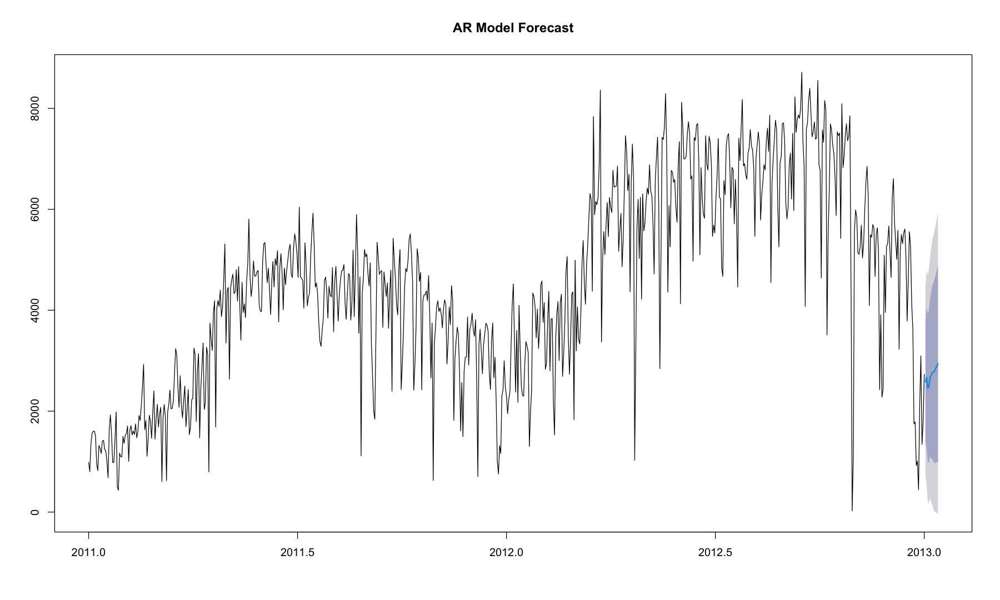

In [26]:
p <- 5

# Fit the AR model using arima() with (p, 0, 0) on the training data
ar_model <- arima(ts(bike_sharing_data$cnt, start = c(2011, 01,01), frequency = 365), order = c(p, 0, 0))

# Display the summary of the model
summary(ar_model)

# Forecast future values
forecasted_values <- forecast(ar_model, h = 12)  # Forecast for the next 12 periods
plot(forecasted_values, main = "AR Model Forecast")

In R, we can use the arima function to specify an AR model by setting the order parameter to ((p, 0, 0)), where ( p ) is the number of autoregressive terms.

* order = c(p, 0, 0): Specifies an AR model of order ( p ) with no differencing or moving average terms.
* summary(ar_model): Displays the coefficients and diagnostics of the fitted model.
* forecast(ar_model, h = 12): Generates forecasts for the next 12 time steps. The value of h can be adjusted depending on the desired forecast horizon.

The AR model is ideal for time series with a strong autocorrelation structure and no need for differencing (stationary series). The PACF plot helps identify the appropriate lag order ( p ) for the model, and the fitted AR model can then be used for forecasting future values.



## 2. Moving Average (MA) Model

A Moving Average (MA) model is a time series model that uses past error terms to predict future values, capturing the short-term dependencies in a series. In an MA model of order ( q ), denoted as $\text{MA}(q)$, the current value is expressed as a linear combination of the past ( q ) error terms.

The mathematical form of an MA model is:

$$Y_t = \mu + \theta1 \epsilon{t-1} + \theta2 \epsilon{t-2} + \dots + \theta q \epsilon{t-q} + \epsilon_t
$$

where: - ( Y_t ) is the current value of the series. - $\mu$ is the mean of the series. - $\theta_1, \theta_2, \dots, \theta_q$ are the coefficients for each lagged error term. - $\epsilon_t$ is the error term at time ( t ), assumed to be white noise.

The choice of $q$ (number of lagged error terms) is essential for capturing short-term patterns and noise. The autocorrelation function (ACF) plot is often used to determine the appropriate order $q$ by observing where significant autocorrelation cuts off.

### Implementing the MA Model in R

In R, we can fit an MA model using the arima function by setting the order parameter to ((0, 0, q)), where ( q ) is the number of moving average terms.


Call:
arima(x = ts(bike_sharing_data$cnt, start = c(2011, 1, 1), frequency = 365), 
    order = c(0, 0, q))

Coefficients:
         ma1     ma2  intercept
      0.7659  0.4240  4500.3312
s.e.  0.0364  0.0275   100.2748

sigma^2 estimated as 1535789:  log likelihood = -6244,  aic = 12496

Training set error measures:
                   ME    RMSE      MAE       MPE     MAPE     MASE      ACF1
Training set 2.034425 1239.27 973.6934 -42.04485 57.94348 1.334052 0.1722931

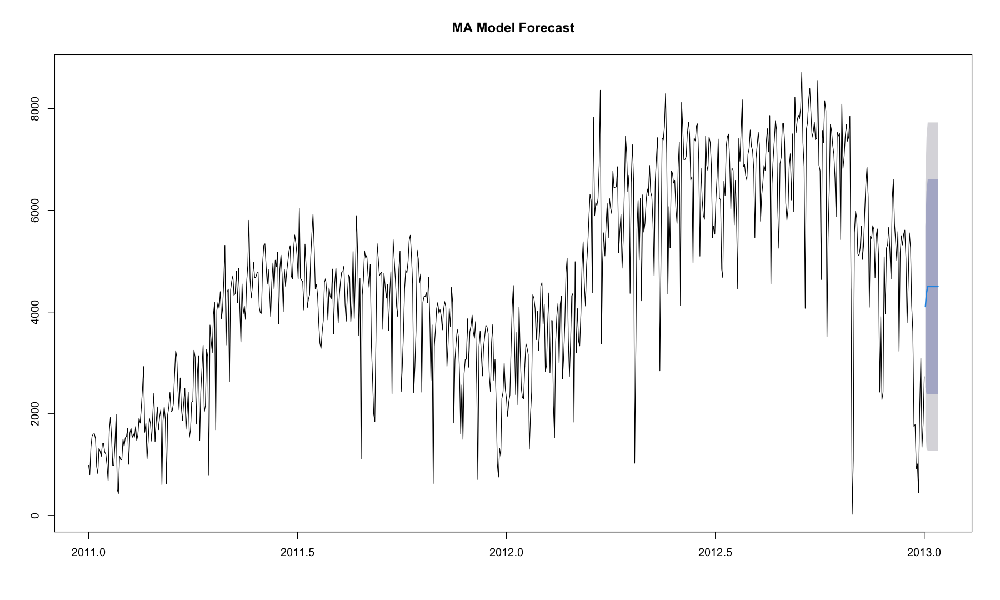

In [27]:
# Define the MA order (q) based on the ACF plot or prior knowledge
q <- 2  # Set this value based on the ACF plot or experimentation

# Fit the MA model using arima() with (0, 0, q)
ma_model <- arima(ts(bike_sharing_data$cnt, start = c(2011, 01,01), frequency = 365), order = c(0, 0, q))

# Display the summary of the model
summary(ma_model)

# Forecast future values
forecasted_values <- forecast(ma_model, h = 12)  # Forecast for the next 12 periods
plot(forecasted_values, main = "MA Model Forecast")

* order = c(0, 0, q): Specifies an MA model of order ( q ) with no autoregressive or differencing terms.
* summary(ma_model): Provides a summary of the fitted model, including coefficient estimates.
* forecast(ma_model, h = 12): Forecasts the next 12 time steps, with h adjustable for different forecast horizons.

The MA model is useful for capturing short-term dependencies in a time series where current values depend on past noise or error terms. By identifying the appropriate lag order ( q ) using the ACF plot, we can build an MA model to forecast future values based on recent patterns in the series.

### 3. ARIMA Model

The ARIMA model, which stands for AutoRegressive Integrated Moving Average, is one of the most popular and flexible time series models for forecasting. It combines the autoregressive (AR) and moving average (MA) components while also incorporating differencing to make non-stationary data stationary. An ARIMA model is specified by three parameters: $p$, $d$, and $q$, where:

* $p$: The number of autoregressive terms (AR part). 
* $d$: The number of times the series is differenced to make it stationary (Integration part).
* $q$: The number of lagged error terms (MA part).

The ARIMA model is denoted as $\text{ARIMA}(p, d, q)$, and it combines these components as follows:

$$
Y_t = \mu + \phi1 Y{t-1} + \phi2 Y{t-2} + \dots + \phi p Y{t-p} + \theta1 \epsilon{t-1} + \theta2 \epsilon{t-2} + \dots + \theta q \epsilon{t-q} + \epsilon_t
$$

where $Y_t$ represents the current value of the series, $\phi_i$ and $\theta_i$ are the coefficients for the AR and MA terms, and $\epsilon_t$ is the error term.

### The steps to fit an ARIMA model typically include:

1. Make the Series Stationary: Use differencing to achieve stationarity if necessary (determined by the ( d ) parameter).
2. Determine ( p ) and ( q ): Use the Partial Autocorrelation Function (PACF) and Autocorrelation Function (ACF) plots to select appropriate lag orders.
3. Fit the ARIMA Model: Estimate the ARIMA model parameters using the chosen ( p ), ( d ), and ( q ) values.
4. Forecast Future Values: Use the fitted model to predict future observations.

Series: ts(bike_sharing_data$cnt, start = c(2011, 1, 1), frequency = 365) 
ARIMA(1,0,2)(0,1,0)[365] with drift 

Coefficients:
         ar1      ma1      ma2   drift
      0.9586  -0.6363  -0.1892  5.7093
s.e.  0.0283   0.0583   0.0506  0.7566

sigma^2 = 1599566:  log likelihood = -3131.76
AIC=6273.52   AICc=6273.68   BIC=6293.03

Training set error measures:
                   ME     RMSE      MAE       MPE     MAPE      MASE       ACF1
Training set 5.357076 890.0137 457.0405 -44.28372 51.73145 0.1967752 0.01047273

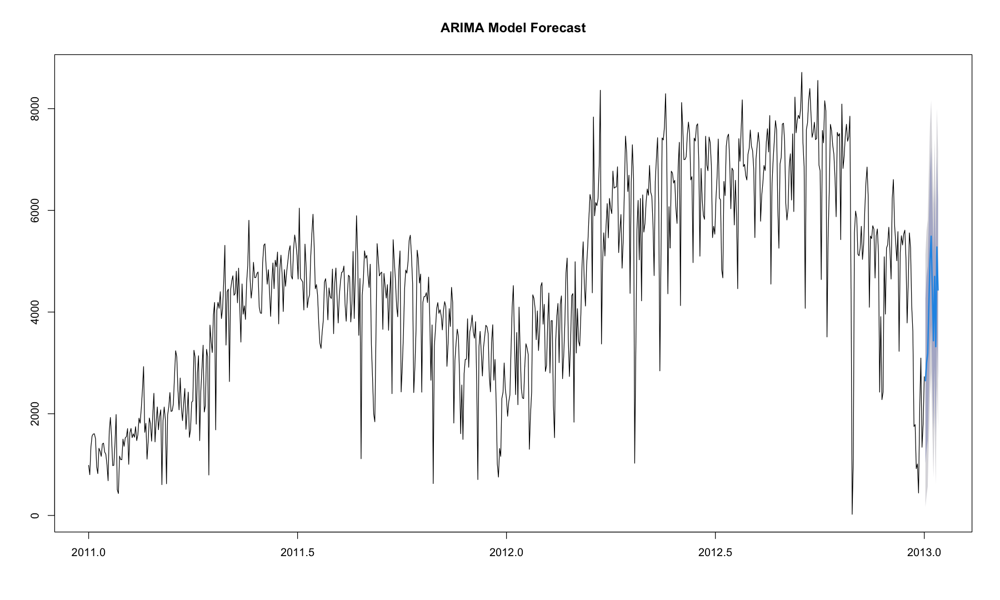

In [28]:
# Automatically fit the best ARIMA model
arima_model <- auto.arima(ts(bike_sharing_data$cnt, start = c(2011, 01,01), frequency = 365))

# Display the summary of the model
summary(arima_model)

# Forecast future values
forecasted_values <- forecast(arima_model, h = 12)  # Forecast for the next 12 periods
plot(forecasted_values, main = "ARIMA Model Forecast")

* auto.arima(data): Automatically selects the optimal values of ( p ), ( d ), and ( q ) based on model selection criteria like AIC (Akaike Information Criterion) or BIC (Bayesian Information Criterion).
* summary(arima_model): Shows the fitted model parameters and diagnostic information.
* forecast(arima_model, h = 12): Generates forecasts for the next 12 time steps, with h adjustable based on the desired forecast period.

The ARIMA model is highly versatile, allowing it to handle various time series patterns, including trends, seasonality (with modifications, such as seasonal ARIMA or SARIMA), and short-term dependencies. The auto.arima function simplifies the model selection process, making it an efficient choice for time series forecasting tasks.

### References and Notes:

1. Forecast Package: https://pkg.robjhyndman.com/forecast/reference/autoplot.acf.html
2. ggACF and ggPacf: https://robjhyndman.com/hyndsight/forecast7-ggplot2/
3. Time Series Handbook: https://phdinds-aim.github.io/time_series_handbook/01_AutoRegressiveIntegratedMovingAverage/01_AutoRegressiveIntegratedMovingAverage.html
4. Fb Prophet: https://facebook.github.io/prophet/